# **Import packages**

In [77]:
!pip install dataprep;
!pip install plotly;
!pip install geopandas;
!pip install mplleaflet

import os
import pandas as pd
import numpy as np

from dataprep.eda import plot, plot_correlation, create_report, plot_missing
import matplotlib.pyplot as plt
import plotly.express as px

import seaborn as sns
import geopandas as gpd
import mplleaflet

plt.style.use('seaborn')
pd.set_option('display.max_rows', None) 

# **Prepare**

## **Load data & rename**

In [78]:
# mount google drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [79]:
CURRENT_DIR = 'drive//MyDrive//IE_500_Data_Mining_I'

# read file
df = pd.read_csv(os.path.join(CURRENT_DIR,'immo_data.csv'), dtype={'geo_plz': str})


## **Clean**

### Remove features

In [80]:
  # drop out-of-scope/duplicate/unnecessary features (now as for pipeline)
  # remove too granular location information
  df = df.drop(columns=[# 'regio2', # keep for plots
                        # 'regio3', # keep for plots
                        'houseNumber',
                        'street',
                        'streetPlain',
                        # 'geo_plz' # keep for maps
                        ])

  # remove all columns with price except total rent
  df = df.drop(columns=['baseRent',
                        'heatingCosts',
                        'serviceCharge']) 

  # remove all columns with duplicate information/bins
  df = df.drop(columns=['firingTypes',
                        'geo_bln',
                        'geo_krs',
                        'noRoomsRange',
                        'yearConstructedRange',
                        'baseRentRange',
                        'livingSpaceRange',
                        # 'newlyConst', # keep for plots
                        # 'energyEfficiencyClass', # keep for plots
                        # 'date' # keep for plots
                        ])

  # remove useless information 
  df = df.drop(columns=['scoutId'])

In [81]:
df.describe()

,telekomHybridUploadSpeed,picturecount,pricetrend,telekomUploadSpeed,totalRent,yearConstructed,noParkSpaces,livingSpace,noRooms,thermalChar,floor,numberOfFloors,lastRefurbish,electricityBasePrice,electricityKwhPrice
count,45020.0,268850.000000,267018.000000,235492.000000,2.283330e+05,211805.000000,93052.000000,268850.000000,268850.000000,162344.000000,217541.000000,171118.000000,80711.000000,46846.000000,46846.000000
mean,10.0,9.791958,3.389001,28.804928,9.013315e+02,1966.400590,1.327634,74.355548,2.641261,114.749533,2.122405,3.572319,2013.904536,89.113612,0.199769
std,0.0,6.408399,1.964874,16.337151,3.323833e+04,46.992207,8.361403,254.759208,2.633440,61.653663,3.634934,6.375496,10.963125,5.395805,0.009667
min,10.0,0.000000,-12.330000,1.000000,0.000000e+00,1000.000000,0.000000,0.000000,1.000000,0.100000,-1.000000,0.000000,1015.000000,71.430000,0.170500
25%,10.0,6.000000,2.000000,10.000000,4.698000e+02,1950.000000,1.000000,54.000000,2.000000,79.000000,1.000000,2.000000,2012.000000,90.760000,0.191500
50%,10.0,9.000000,3.390000,40.000000,6.500000e+02,1973.000000,1.000000,67.320000,3.000000,107.000000,2.000000,3.000000,2017.000000,90.760000,0.198500
75%,10.0,13.000000,4.570000,40.000000,9.850000e+02,1996.000000,1.000000,87.000000,3.000000,140.300000,3.000000,4.000000,2019.000000,90.760000,0.205500
max,10.0,121.000000,14.920000,100.000000,1.575154e+07,2090.000000,2241.000000,111111.000000,999.990000,1996.000000,999.000000,999.000000,2919.000000,90.760000,0.227600


In [82]:
df.info(all)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 268850 entries, 0 to 268849
Data columns (total 35 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   regio1                    268850 non-null  object 
 1   heatingType               223994 non-null  object 
 2   telekomTvOffer            236231 non-null  object 
 3   telekomHybridUploadSpeed  45020 non-null   float64
 4   newlyConst                268850 non-null  bool   
 5   balcony                   268850 non-null  bool   
 6   picturecount              268850 non-null  int64  
 7   pricetrend                267018 non-null  float64
 8   telekomUploadSpeed        235492 non-null  float64
 9   totalRent                 228333 non-null  float64
 10  yearConstructed           211805 non-null  float64
 11  noParkSpaces              93052 non-null   float64
 12  hasKitchen                268850 non-null  bool   
 13  cellar                    268850 non-null  b

### Remove outlier tuples

In [83]:
# Drop all tuples that do not have a value for totalRent assinged
df.dropna(subset = ["totalRent"], inplace=True)

In [84]:
outlier_removal_on = 0 # set to 1 turn on outlier removal (slow!), otherwise set to 0

In [85]:
if outlier_removal_on == 1:
  print("Amount of rows before removal: " + str(len(df)))

  # Create df to store upper and lower limits
  outliers = pd.DataFrame(columns =['Feature', 'Lower', 'Upper'])

  # define upper and lower limits based on standard deviation
  def outlier_removal_strong(df, variable):
      upper_limit = df[variable].mean() + 0.75 * df[variable].std()
      lower_limit = df[variable].mean() - 0.75 * df[variable].std()
      if lower_limit <0:
        lower_limit = 0 # do not allow for negative values
      return upper_limit, lower_limit

  # define features that should be subject to strong outlier removal
  outlier_features_strong = ['totalRent']

  # calculate strong upper and lower limits
  for i in outlier_features_strong: 
    upper_limit, lower_limit = outlier_removal_strong(df, i)
    new_row = {'Feature':i, 'Lower':lower_limit, 'Upper':upper_limit}
    outliers = outliers.append(new_row, ignore_index=True)

  # light outlier removal for every numeric feature was rejected in pipeline due to worse results but allows for better illustration in graphs
  def outlier_removal_light(df, variable):
      upper_limit = df[variable].mean() + 3 * df[variable].std()
      lower_limit = df[variable].mean() - 3 * df[variable].std()
      if lower_limit <0:
        lower_limit = 0 # do not allow for negative values
      return upper_limit, lower_limit

  # define features that should be subject to light outlier removal
  outlier_features_light = ['picturecount', 'pricetrend', 'yearConstructed', 'noParkSpaces', 'livingSpace', 'noRooms', 'thermalChar', 'floor', 'numberOfFloors', 'lastRefurbish']

  # calculate light upper and lower limits
  for i in outlier_features_light: 
    upper_limit, lower_limit = outlier_removal_light(df, i)
    new_row = {'Feature':i, 'Lower':lower_limit, 'Upper':upper_limit}
    outliers = outliers.append(new_row, ignore_index=True)

  # remove outliers based on upper and lower limits
  # attention, very slow when including light outlier removal
  for i in outliers.index:
    feature = outliers['Feature'][i]
    print("")
    print(feature)
    upper = outliers['Upper'][i]
    print("Upper limit: " +str(upper))
    lower = outliers['Lower'][i]
    print("Lower limit: " +str(lower))
    dropped = 0
    for j in df.index:
      if (not pd.isnull(df[feature][j])):
          if ((df[feature][j] < lower) | (df[feature][j] > upper)):
            df.drop(j, inplace=True)
            dropped = dropped+1
    print("Dropped: "+ str(dropped))

  print("")
  print("Amount of rows remaining after removal: " + str(len(df)))

# **Show info of cleaned dataset**

In [86]:
df.describe()

,telekomHybridUploadSpeed,picturecount,pricetrend,telekomUploadSpeed,totalRent,yearConstructed,noParkSpaces,livingSpace,noRooms,thermalChar,floor,numberOfFloors,lastRefurbish,electricityBasePrice,electricityKwhPrice
count,37853.0,228333.000000,226724.000000,200283.000000,2.283330e+05,179048.000000,77549.000000,228333.00000,228333.000000,134600.000000,187963.000000,148984.000000,72805.000000,39455.000000,39455.000000
mean,10.0,9.868495,3.394387,28.928361,9.013315e+02,1965.701499,1.310655,73.68226,2.619613,113.937084,2.131888,3.581492,2013.863856,89.111892,0.200080
std,0.0,6.441233,2.002065,16.302435,3.323833e+04,47.852184,4.155981,273.76076,1.726725,59.848315,3.554003,5.887249,10.750599,5.398371,0.009629
min,10.0,0.000000,-12.330000,1.000000,0.000000e+00,1000.000000,0.000000,0.00000,1.000000,0.100000,-1.000000,0.000000,1015.000000,71.430000,0.170500
25%,10.0,6.000000,1.960000,10.000000,4.698000e+02,1940.000000,1.000000,54.00000,2.000000,79.000000,1.000000,2.000000,2012.000000,90.760000,0.191500
50%,10.0,9.000000,3.390000,40.000000,6.500000e+02,1972.000000,1.000000,67.00000,3.000000,106.000000,2.000000,3.000000,2017.000000,90.760000,0.198500
75%,10.0,13.000000,4.600000,40.000000,9.850000e+02,1996.000000,1.000000,86.00000,3.000000,139.000000,3.000000,4.000000,2019.000000,90.760000,0.205500
max,10.0,112.000000,14.920000,100.000000,1.575154e+07,2090.000000,320.000000,111111.00000,560.000000,1983.000000,999.000000,999.000000,2919.000000,90.760000,0.227600


In [87]:
df.info(all)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 228333 entries, 0 to 268848
Data columns (total 35 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   regio1                    228333 non-null  object 
 1   heatingType               191510 non-null  object 
 2   telekomTvOffer            200904 non-null  object 
 3   telekomHybridUploadSpeed  37853 non-null   float64
 4   newlyConst                228333 non-null  bool   
 5   balcony                   228333 non-null  bool   
 6   picturecount              228333 non-null  int64  
 7   pricetrend                226724 non-null  float64
 8   telekomUploadSpeed        200283 non-null  float64
 9   totalRent                 228333 non-null  float64
 10  yearConstructed           179048 non-null  float64
 11  noParkSpaces              77549 non-null   float64
 12  hasKitchen                228333 non-null  bool   
 13  cellar                    228333 non-null  b

# **Create report**

In [88]:
report = create_report(df, title='My Report')

In [89]:
# save report to html as it cannot be displayed in Jupyter Notebook
CURRENT_DIR = 'drive//MyDrive//IE_500_Data_Mining_I//EDA//Graphs'
if outlier_removal_on == 0:
  report.save(os.path.join(CURRENT_DIR, 'html_report.html'))
if outlier_removal_on == 1:
  report.save(os.path.join(CURRENT_DIR, 'html_report_wo.html'))

Report has been saved to drive/MyDrive/IE_500_Data_Mining_I/EDA/Graphs/html_report.html!


# **Plot data**

## **Plot all attributes by frequency/count**


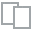
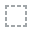
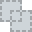
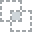
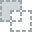
...
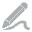
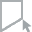
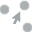
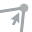
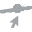

In [90]:
plot(df)

In [91]:
# save plot as png for presentation
if outlier_removal_on == 0:
  plot(df).save(os.path.join(CURRENT_DIR,'html_plot_counts.html'))
if outlier_removal_on == 1:
  plot(df).save(os.path.join(CURRENT_DIR,'html_plot_counts_wo.html'))

## **Plot scatter matrices**

In [92]:
# plot expectably highly relevant features
fig = px.scatter_matrix(df, dimensions=["totalRent", 
                                        "livingSpace", 
                                        "noRooms",  
                                        "yearConstructed"], color="regio1", width=1200, height=1000)
fig.update_traces(diagonal_visible=False)

# save plot as html for presentation
if outlier_removal_on == 0:
  fig.write_html(os.path.join(CURRENT_DIR,'html_scatter_01.html'))
if outlier_removal_on == 1:
  fig.write_html(os.path.join(CURRENT_DIR,'html_scatter_01_wo.html'))  

fig.show()

In [93]:
# plot features expected to be related regarding energy usage
fig = px.scatter_matrix(df, dimensions=["heatingType", 
                                        "lastRefurbish", 
                                        "livingSpace", 
                                        "thermalChar", 
                                        "typeOfFlat", 
                                        "yearConstructed"], color="regio1", width=1400, height=1300)
fig.update_traces(diagonal_visible=False)

# save plot as html for presentation
if outlier_removal_on == 0:
  fig.write_html((os.path.join(CURRENT_DIR,'html_scatter_02.html')))
if outlier_removal_on == 1:
  fig.write_html((os.path.join(CURRENT_DIR,'html_scatter_02_wo.html')))

fig.show()

## **Plot mean price**

### Plot mean price by state

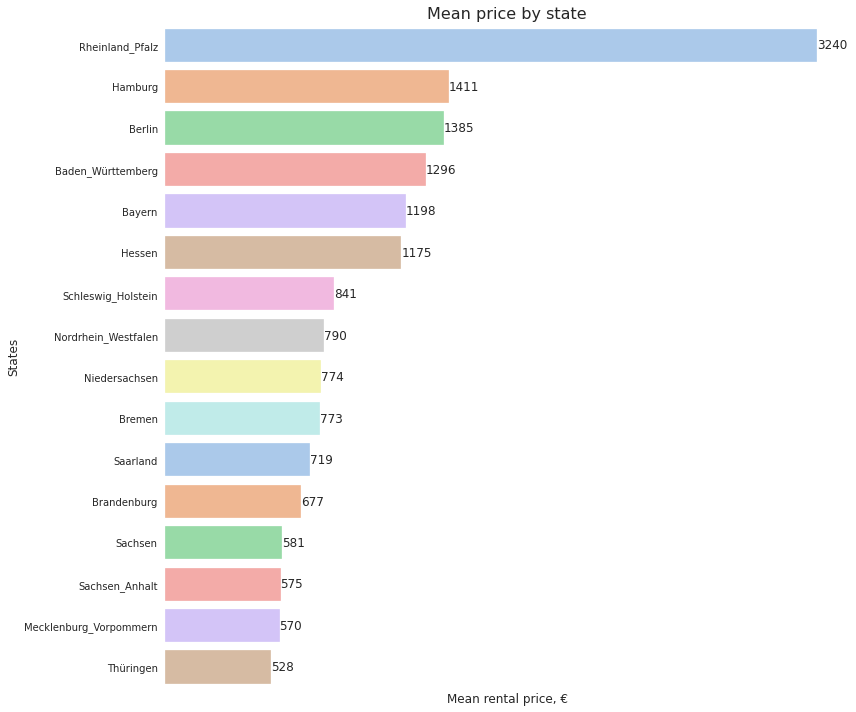

In [94]:
# thanks to @ https://www.kaggle.com/sinchetru/22-06-2020-sinchetru-koeln-rental-market

df_state_pv = df.pivot_table(values='totalRent', index='regio1', aggfunc=(np.mean)).reset_index()
df_state_pv = df_state_pv.sort_values(by=['totalRent'], ascending=False)
df_state_pv['totalRent'] = df_state_pv['totalRent'].astype(int)

sns.set_style('white')

fig = plt.subplots(figsize=(12, 10))
ax = sns.barplot(x='totalRent',
                 y='regio1',
                 data=df_state_pv,
                 orient='h',
                 palette='pastel')

n = 0
for land, value in df_state_pv.iterrows():
    ax.text(x=value[1], 
            y=n, 
            s=value[1], 
            fontsize=12,  
            horizontalalignment='left', 
            verticalalignment='center')
    n += 1

ax.tick_params(axis='x', labelsize=10, labelbottom=False)
ax.tick_params(axis='y', labelsize=10, bottom='off')
ax.set_title('Mean price by state', fontsize=16)

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(False)


ax.set_ylabel('States', fontsize=12)
ax.set_xlabel('Mean rental price, €', fontsize=12)
plt.tight_layout()

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbystate.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbystate_wo.png'))

plt.show()

In [95]:
df_state_pv

,regio1,totalRent
10,Rheinland_Pfalz,3240
5,Hamburg,1411
2,Berlin,1385
0,Baden_Württemberg,1296
1,Bayern,1198
6,Hessen,1175
14,Schleswig_Holstein,841
9,Nordrhein_Westfalen,790
8,Niedersachsen,774
4,Bremen,773


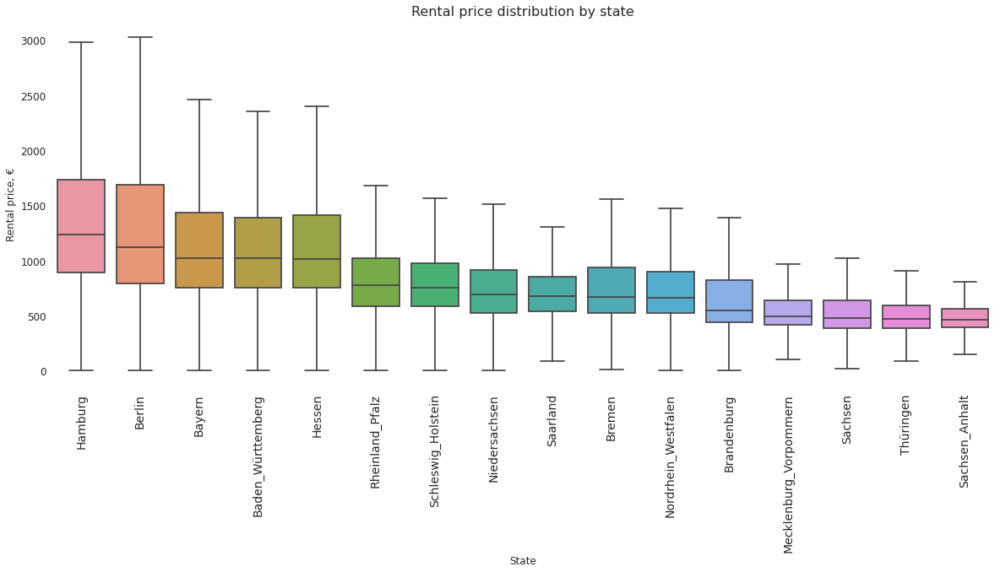

In [96]:
# thanks to @ https://www.kaggle.com/sinchetru/22-06-2020-sinchetru-koeln-rental-market

fig = plt.subplots(figsize=(20, 8))

my_order = df.groupby(by=['regio1'])['totalRent'].median().sort_values(ascending=False).index
ax = sns.boxplot(x='regio1',
                 y='totalRent',
                 data=df,
                 order=my_order,
                 showfliers=False)

ax.tick_params(axis='x', labelrotation=90, labelsize=14)
ax.tick_params(axis='y', labelsize=12)
ax.set_title('Rental price distribution by state', fontsize=16)

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(True)

ax.set_xlabel('State', fontsize=12)
ax.set_ylabel('Rental price, €', fontsize=12)

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_distribution_meanbystate.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_distribution_meanbystate_wo.png'))

plt.show()

### Plot mean price by district (Top 25 & bottom 25)

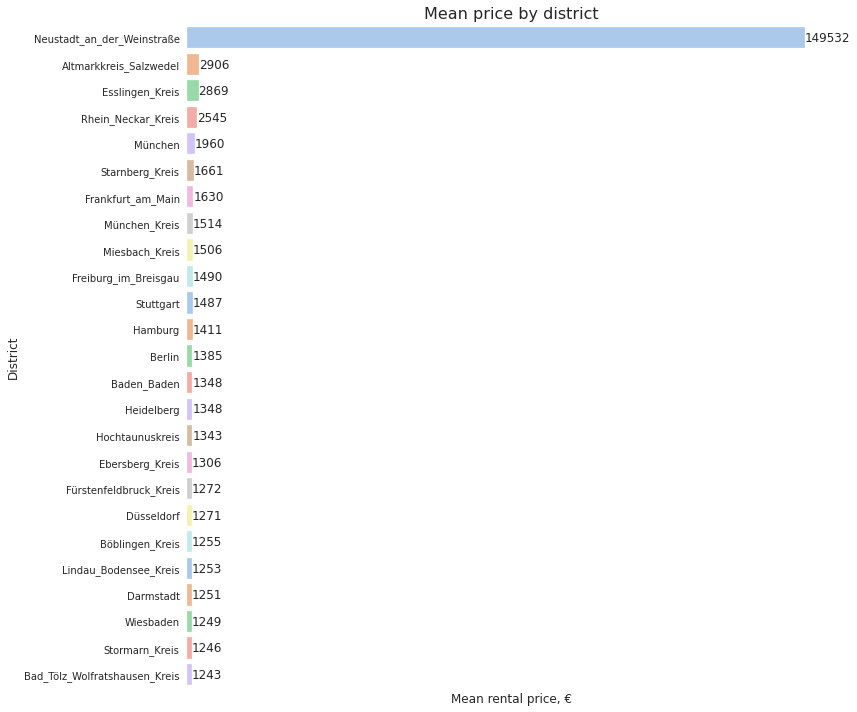

In [97]:
# thanks to @ https://www.kaggle.com/sinchetru/22-06-2020-sinchetru-koeln-rental-market

df_district_pv = df.pivot_table(values='totalRent', index='regio2', aggfunc=(np.mean)).reset_index()
df_district_pv = df_district_pv.sort_values(by=['totalRent'], ascending=False)
df_district_pv['totalRent'] = df_district_pv['totalRent'].astype(int)
df_district_pv = df_district_pv.head(25) # reduce to top 25

sns.set_style('white')

fig = plt.subplots(figsize=(12, 10))
ax = sns.barplot(x='totalRent',
                 y='regio2',
                 data=df_district_pv,
                 orient='h',
                 palette='pastel')

n = 0
for land, value in df_district_pv.iterrows():
    ax.text(x=value[1], 
            y=n,  
            s=value[1],  
            fontsize=12, 
            horizontalalignment='left', 
            verticalalignment='center')
    n += 1

ax.tick_params(axis='x', labelsize=10, labelbottom=False)
ax.tick_params(axis='y', labelsize=10, bottom='off')
ax.set_title('Mean price by district', fontsize=16)

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(False)


ax.set_ylabel('District', fontsize=12)
ax.set_xlabel('Mean rental price, €', fontsize=12)
plt.tight_layout()

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbydistrict_top.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbydistrict_top_wo.png'))

plt.show()

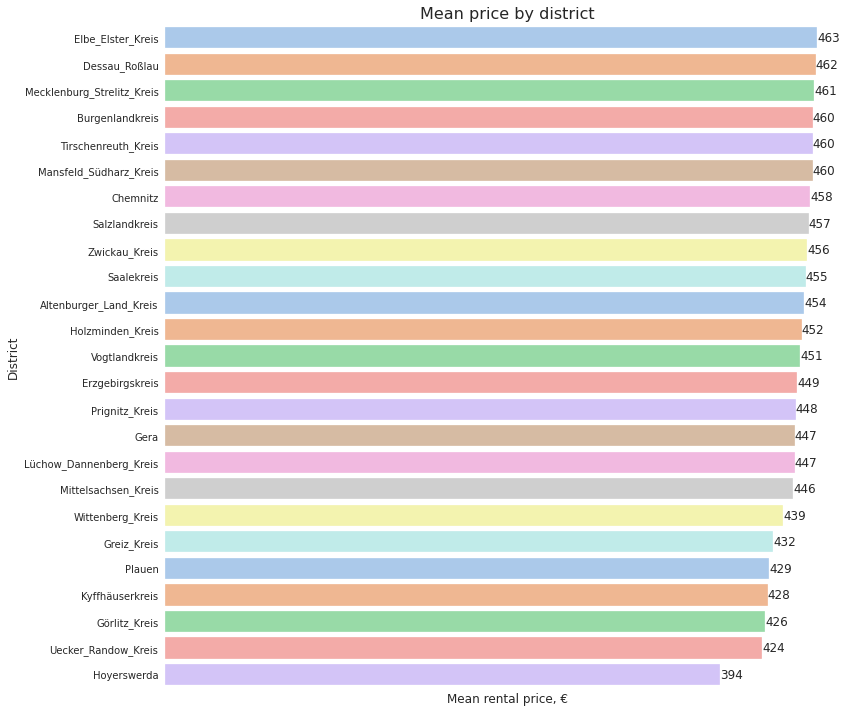

In [98]:
# thanks to @ https://www.kaggle.com/sinchetru/22-06-2020-sinchetru-koeln-rental-market

df_district_pv = df.pivot_table(values='totalRent', index='regio2', aggfunc=(np.mean)).reset_index()
df_district_pv = df_district_pv.sort_values(by=['totalRent'], ascending=False)
df_district_pv['totalRent'] = df_district_pv['totalRent'].astype(int)
df_district_pv = df_district_pv.tail(25) # reduce to bottom 25

sns.set_style('white')

fig = plt.subplots(figsize=(12, 10))
ax = sns.barplot(x='totalRent',
                 y='regio2',
                 data=df_district_pv,
                 orient='h',
                 palette='pastel')

n = 0
for land, value in df_district_pv.iterrows():
    ax.text(x=value[1],  
            y=n,  
            s=value[1],  
            fontsize=12, 
            horizontalalignment='left',
            verticalalignment='center')
    n += 1

ax.tick_params(axis='x', labelsize=10, labelbottom=False)
ax.tick_params(axis='y', labelsize=10, bottom='off')
ax.set_title('Mean price by district', fontsize=16)

ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(True)
ax.spines['bottom'].set_visible(False)


ax.set_ylabel('District', fontsize=12)
ax.set_xlabel('Mean rental price, €', fontsize=12)
plt.tight_layout()

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbydistrict_bottom.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbydistrict_bottom_wo.png'))


plt.show()

### Plotting mean price by number of rooms

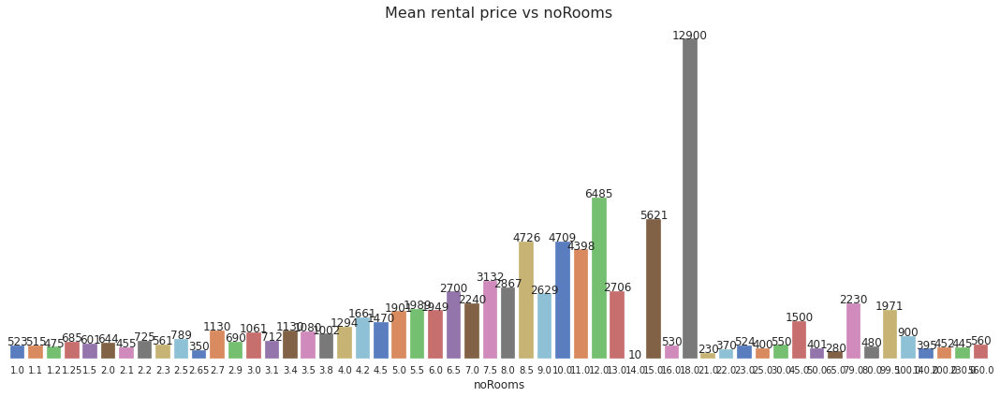

In [99]:
# thanks to @ https://www.kaggle.com/sinchetru/22-06-2020-sinchetru-koeln-rental-market

nr_pv = df.pivot_table(values='totalRent', index='noRooms', aggfunc=(np.mean))
nr_pv = nr_pv.sort_values(by='noRooms', ascending=True).round().reset_index()

sns.set_style('white')
fig = plt.subplots(figsize=(15, 6))
ax = sns.barplot(x='noRooms', y='totalRent', data=nr_pv, palette='muted')

for zn, value in nr_pv.iterrows():
  ax.text(x=zn, 
  y=value[1]+20,  
  s=int(value[1]), 
  fontsize=12,  
  horizontalalignment='center',  
  verticalalignment='baseline')

ax.tick_params(axis='x', labelsize=10)
ax.set_title('Mean rental price vs noRooms', fontsize=16)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(True)
ax.yaxis.set_visible(False)
ax.set_xlabel('noRooms', fontsize=12)

plt.tight_layout()

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbynoroom.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbynoroom_wo.png'))

plt.show()

### Plot mean price by living space, interior quality, construction year, appartment type

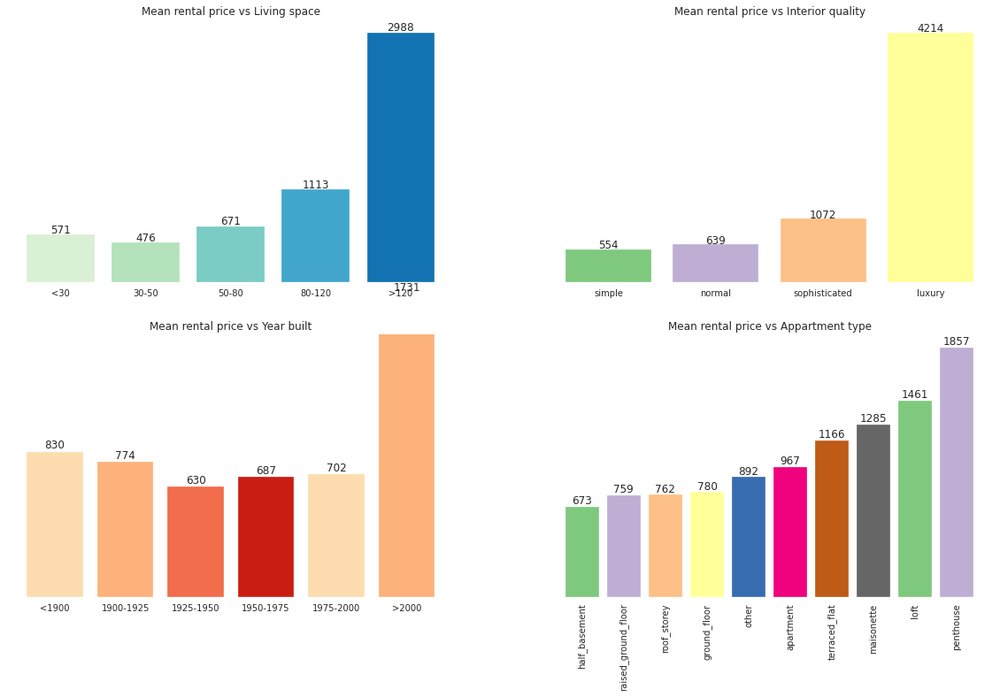

In [100]:
# thanks to @ https://www.kaggle.com/sinchetru/22-06-2020-sinchetru-koeln-rental-market

# Binning livingSpace
bins = [0, 30, 50, 80, 120, np.inf]
names = ['<30', '30-50', '50-80', '80-120', '>120']
df['livingSpace_bin'] = pd.cut(df['livingSpace'], bins, labels=names)

# Binning the yearConstructed
bins = [0, 1900, 1925, 1950, 1975, 2000, np.inf]
names = ['<1900', '1900-1925', '1925-1950', '1950-1975', '1975-2000', '>2000']
df['yearConstructed_bin'] = pd.cut(df['yearConstructed'], bins, labels=names)

# pivot data for individual plots
ls_pv = df.pivot_table(values='totalRent',
                             index='livingSpace_bin',
                             aggfunc=(np.mean)).astype(int).reset_index()

intq_pv = df.pivot_table(values='totalRent',
                               index='interiorQual',
                               aggfunc=(np.mean)).sort_values(by='totalRent').astype(int).reset_index()

bj_pv = df.pivot_table(values='totalRent',
                             index='yearConstructed_bin',
                             aggfunc=(np.mean)).sort_values(by='yearConstructed_bin').astype(int).reset_index()

wt_pv = df.pivot_table(values='totalRent',
                             index='typeOfFlat',
                             aggfunc=(np.mean)).sort_values(by='totalRent').astype(int).reset_index()

# Plotting
fig = plt.figure(figsize=(20, 12))

ax1 = fig.add_subplot(2, 2, 1)
ax2 = fig.add_subplot(2, 2, 2)
ax3 = fig.add_subplot(2, 2, 3)
ax4 = fig.add_subplot(2, 2, 4)

ax1.bar(ls_pv['livingSpace_bin'], ls_pv['totalRent'], color=sns.color_palette('GnBu', 5))
ax2.bar(intq_pv['interiorQual'], intq_pv['totalRent'], color=sns.color_palette('Accent', 4))
ax3.bar(bj_pv['yearConstructed_bin'], bj_pv['totalRent'], color=sns.color_palette('OrRd', 4))
ax4.bar(wt_pv['typeOfFlat'], wt_pv['totalRent'], color=sns.color_palette('Accent', 10))

for zn, value in ls_pv.iterrows():
    ax1.text(x=zn, 
            y=value[1]+20,  
            s=int(value[1]), 
            fontsize=12, 
            horizontalalignment='center',  
            verticalalignment='baseline')

for zn, value in intq_pv.iterrows():
    ax2.text(x=zn,
             y=value[1]+20,
             s=int(value[1]),
             fontsize=12,
             horizontalalignment='center',
             verticalalignment='baseline')

for zn, value in bj_pv.iterrows():
    ax3.text(x=zn,
             y=value[1]+20,
             s=int(value[1]),
             fontsize=12,
             horizontalalignment='center',
             verticalalignment='baseline')

for zn, value in wt_pv.iterrows():
    ax4.text(x=zn,
             y=value[1]+20,
             s=int(value[1]),
             fontsize=12,
             horizontalalignment='center',
             verticalalignment='baseline')

ax1.set_title('Mean rental price vs Living space', fontsize=12)
ax2.set_title('Mean rental price vs Interior quality', fontsize=12)
ax3.set_title('Mean rental price vs Year built', fontsize=12)
ax4.set_title('Mean rental price vs Appartment type', fontsize=12)

ax1.spines['right'].set_visible(False)
ax1.spines['top'].set_visible(False)
ax1.spines['left'].set_visible(False)
ax1.spines['bottom'].set_visible(True)
ax1.yaxis.set_visible(False)

ax2.spines['right'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax2.spines['left'].set_visible(False)
ax2.spines['bottom'].set_visible(True)
ax2.yaxis.set_visible(False)

ax3.spines['right'].set_visible(False)
ax3.spines['top'].set_visible(False)
ax3.spines['left'].set_visible(False)
ax3.spines['bottom'].set_visible(True)
ax3.yaxis.set_visible(False)
ax3.set_ylim(0,1500)

ax4.spines['right'].set_visible(False)
ax4.spines['top'].set_visible(False)
ax4.spines['left'].set_visible(False)
ax4.spines['bottom'].set_visible(True)
ax4.yaxis.set_visible(False)
ax4.tick_params(axis='x', labelrotation=90, labelsize=10)

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbyvarious.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_bar_meanbyvarious_wo.png'))

plt.show()

# **Plot data with additional information**

## **Plot mean price (advanced)**

### Plot mean price by living space (advanced)



Group by state

In [101]:
fig = px.scatter(df, x='livingSpace', y='totalRent', color='regio1', marginal_y='violin',
           marginal_x='box', template='simple_white', width=1000, height=700)

# save plot as html for presentation
if outlier_removal_on == 0:
  fig.write_html(os.path.join(CURRENT_DIR,'html_scatter_meanbyspace_adv.html'))
if outlier_removal_on == 1:
  fig.write_html(os.path.join(CURRENT_DIR,'html_scatter_meanbyspace_adv_wo.html'))

fig.show()

### Plot mean price in München (most expensive) by number of Rooms, living space and date (advanced)

In [102]:
fig = px.scatter(df.query('regio2=="München"'), x='livingSpace', y='noRooms', size='totalRent', color='date', log_x=True, size_max=60)

# save plot as html for presentation
if outlier_removal_on == 0:
  fig.write_html(os.path.join(CURRENT_DIR,'html_scatter_meanbynorooms+livingspace_muc.html'))
if outlier_removal_on == 1:
  fig.write_html(os.path.join(CURRENT_DIR,'html_scatter_meanbynorooms+livingspace_muc_wo.html'))

fig.show()

### Plot mean price in Plauen (cheapest) by number of Rooms, living space and date (advanced)

In [103]:
fig = px.scatter(df.query('regio2=="Plauen"'), x='livingSpace', y='noRooms', size='totalRent', color='date', log_x=True, size_max=60)

# save plot as html for presentation
if outlier_removal_on == 0:
  fig.write_html(os.path.join(CURRENT_DIR,'html_scatter_meanbynorooms+livingspace_pla.html'))
if outlier_removal_on == 1:
  fig.write_html(os.path.join(CURRENT_DIR,'html_scatter_meanbynorooms+livingspace_pla_wo.html'))

fig.show()

### Plot Map

In [104]:
# red in shapes of zip areas
CURRENT_DIR = 'drive//MyDrive//IE_500_Data_Mining_I//EDA'
plz_shape_df = gpd.read_file(os.path.join(CURRENT_DIR,'plz-gebiete.shp'), dtype={'plz': str})

plt.rcParams['figure.figsize'] = [16, 11]

# add major cities for orientation
top_cities = {
    'Berlin': (13.404954, 52.520008), 
    'Cologne': (6.953101, 50.935173),
    'Düsseldorf': (6.782048, 51.227144),
    'Frankfurt am Main': (8.682127, 50.110924),
    'Hamburg': (9.993682, 53.551086),
    'Leipzig': (12.387772, 51.343479),
    'Munich': (11.576124, 48.137154),
    'Dortmund': (7.468554, 51.513400),
    'Stuttgart': (9.181332, 48.777128),
    'Nuremberg': (11.077438, 49.449820),
    'Hannover': (9.73322, 52.37052)
}

In [105]:
# pivot immoscout data based on zip code
df_plz_pv = df.pivot_table(values='totalRent', index='geo_plz', aggfunc=(np.mean)).reset_index()
df_plz_pv = df_plz_pv.sort_values(by=['totalRent'], ascending=False)
df_plz_pv['totalRent'] = df_plz_pv['totalRent'].astype(int)
df_plz_pv['geo_plz'] = df_plz_pv['geo_plz'].astype(str)
df_plz_pv.rename(columns={"geo_plz": "plz"}, inplace=True)

In [106]:
df_plz_pv.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 7373 entries, 4668 to 78
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   plz        7373 non-null   object
 1   totalRent  7373 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 172.8+ KB


In [107]:
plz_shape_df.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 8725 entries, 0 to 8724
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   plz       8725 non-null   object  
 1   note      8724 non-null   object  
 2   geometry  8725 non-null   geometry
dtypes: geometry(1), object(2)
memory usage: 204.6+ KB


In [108]:
# create merged df for germany based on pivoted immoscout data and zip shapes
germany_df = pd.merge(
    left=plz_shape_df, 
    right=df_plz_pv, 
    on='plz',
    how='left'
)

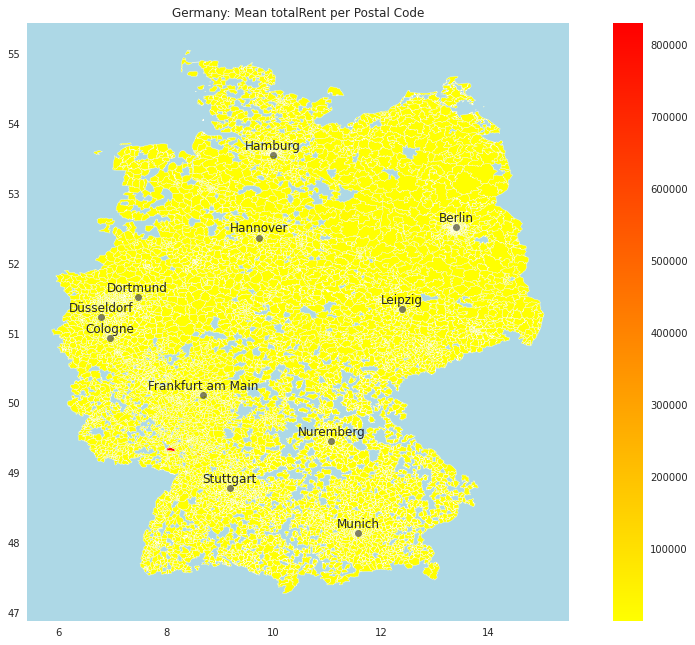

In [109]:
# Plotting
fig, ax = plt.subplots()

germany_df.plot(
    ax=ax, 
    column='totalRent', 
    categorical=False, 
    legend=True, 
    cmap='autumn_r',
    alpha=1,
)

for c in top_cities.keys():

    ax.text(
        x=top_cities[c][0], 
        y=top_cities[c][1] + 0.08, 
        s=c, 
        fontsize=12,
        ha='center', 
    )

    ax.plot(
        top_cities[c][0], 
        top_cities[c][1], 
        marker='o',
        c='black', 
        alpha=0.5
    )
    
ax.set(
    title='Germany: Mean totalRent per Postal Code', 
    aspect=1.3, 
    facecolor='lightblue'
);

# save plot as png for presentation
CURRENT_DIR = 'drive//MyDrive//IE_500_Data_Mining_I//EDA//Graphs'
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_germany_meanbyplz.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_germany_meanbyplz_wo.png'))

plt.show()

In [110]:
# filter & pivot df for data from mannheim
df_mannheim = df[df['regio2'].str.contains('Mannheim')]
df_plz_mannheim_pv = df_mannheim.pivot_table(values='totalRent', index='geo_plz', aggfunc=(np.mean)).reset_index()
df_plz_mannheim_pv = df_plz_mannheim_pv.sort_values(by=['totalRent'], ascending=False)
df_plz_mannheim_pv['totalRent'] = df_plz_mannheim_pv['totalRent'].astype(int)
df_plz_mannheim_pv['geo_plz'] = df_plz_mannheim_pv['geo_plz'].astype(str)
df_plz_mannheim_pv.rename(columns={"geo_plz": "plz"}, inplace=True)

In [111]:
# create merged df for mannheim based on pivoted immoscout data and zip shapes
mannheim_df = pd.merge(
    left=plz_shape_df, 
    right=df_plz_mannheim_pv, 
    on='plz',
    how='left'
)

# drop tuples for zip codes without values
mannheim_df.dropna(subset = ["totalRent"], inplace=True)

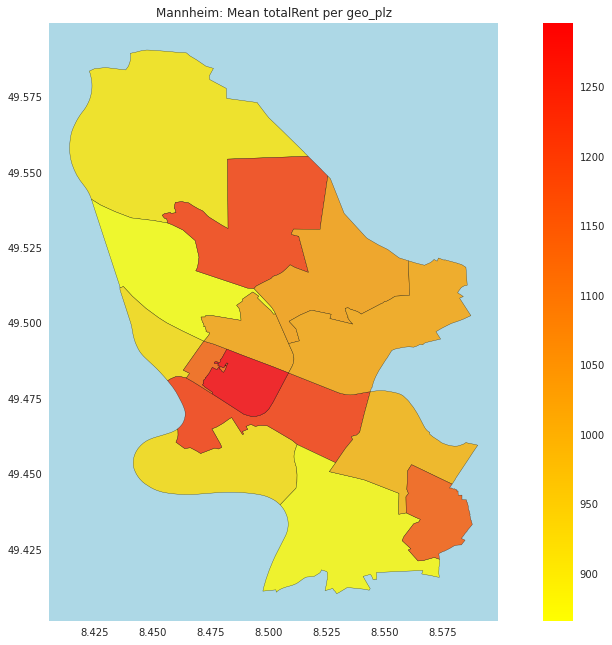

In [112]:
# Plotting
fig, ax = plt.subplots()

mannheim_df.plot(
    ax=ax, 
    column='totalRent', 
    categorical=False, 
    legend=True, 
    cmap='autumn_r',
    alpha=0.8,
    edgecolor='black'
)

ax.set(
    title='Mannheim: Mean totalRent per geo_plz', 
    aspect=1.3, 
    facecolor='lightblue'
)

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_mannheim_meanbyplz.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_mannheim_meanbyplz_wo.png'))

plt.show()

In [113]:
# Plotting
fig, ax = plt.subplots()

mannheim_df.plot(
    ax=ax, 
    column='totalRent', 
    cmap='autumn_r',
    alpha=1,
    edgecolor='black'
)

# show as mpleaf & save plot as html for presentation
if outlier_removal_on == 0:
  mplleaflet.show(fig=fig, path=os.path.join(CURRENT_DIR,'html_mannheim_map.html'))
if outlier_removal_on == 1:
  mplleaflet.show(fig=fig, path=os.path.join(CURRENT_DIR,'html_mannheim_map_wo.html'))

mplleaflet.display(fig=fig)

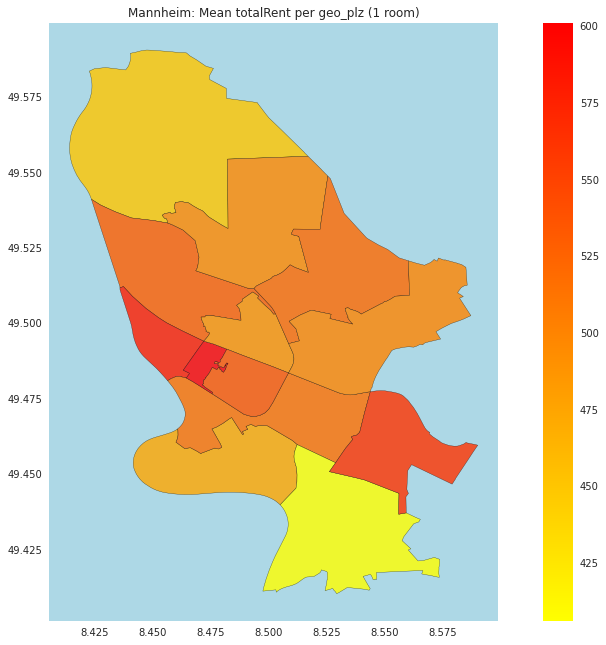

In [114]:
# filter & pivot mannheim df for data of 1 room appt.
df_mannheim_noro1 = df_mannheim[df_mannheim['noRooms'] == 1]
df_mannheim_noro1_pv = df_mannheim_noro1.pivot_table(values='totalRent', index='geo_plz', aggfunc=(np.mean)).reset_index()
df_mannheim_noro1_pv = df_mannheim_noro1_pv.sort_values(by=['totalRent'], ascending=False)
df_mannheim_noro1_pv['totalRent'] = df_mannheim_noro1_pv['totalRent'].astype(int)
df_mannheim_noro1_pv['geo_plz'] = df_mannheim_noro1_pv['geo_plz'].astype(str)
df_mannheim_noro1_pv.rename(columns={"geo_plz": "plz"}, inplace=True)

# create merged df for mannheim 1 room appt. based on pivoted immoscout data and zip shapes
mannheim_noro1_df = pd.merge(
    left=plz_shape_df, 
    right=df_mannheim_noro1_pv, 
    on='plz',
    how='left'
)

# drop tuples for zip codes without values
mannheim_noro1_df.dropna(subset = ["totalRent"], inplace=True)

# Plotting
fig, ax = plt.subplots()

mannheim_noro1_df.plot(
    ax=ax, 
    column='totalRent', 
    categorical=False, 
    legend=True, 
    cmap='autumn_r',
    alpha=0.8,
    edgecolor='black'
)

ax.set(
    title='Mannheim: Mean totalRent per geo_plz (1 room)', 
    aspect=1.3, 
    facecolor='lightblue'
)

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_mannheim_meanbyplz_1room.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_mannheim_meanbyplz_1room_wo.png'))

plt.show()

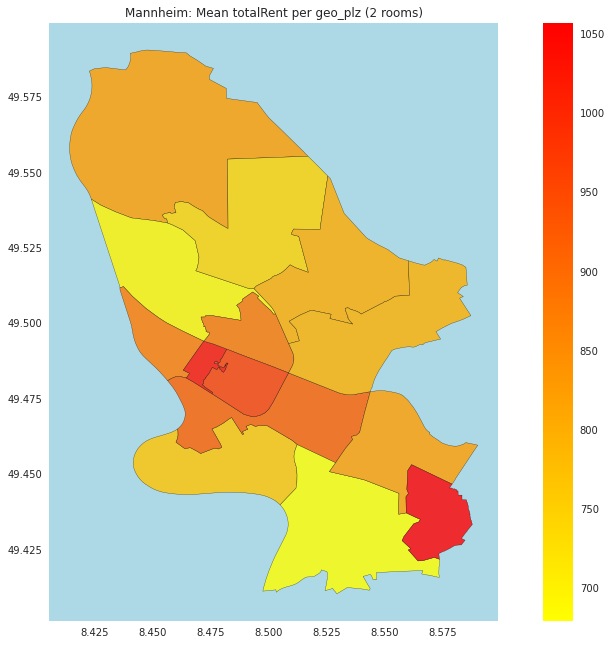

In [115]:
# filter & pivot mannheim df for data of 2 room appt.
df_mannheim_noro2 = df_mannheim[df_mannheim['noRooms'] == 2]
df_mannheim_noro2_pv = df_mannheim_noro2.pivot_table(values='totalRent', index='geo_plz', aggfunc=(np.mean)).reset_index()
df_mannheim_noro2_pv = df_mannheim_noro2_pv.sort_values(by=['totalRent'], ascending=False)
df_mannheim_noro2_pv['totalRent'] = df_mannheim_noro2_pv['totalRent'].astype(int)
df_mannheim_noro2_pv['geo_plz'] = df_mannheim_noro2_pv['geo_plz'].astype(str)
df_mannheim_noro2_pv.rename(columns={"geo_plz": "plz"}, inplace=True)

# create merged df for mannheim 2 room appt. based on pivoted immoscout data and zip shapes
mannheim_noro2_df = pd.merge(
    left=plz_shape_df, 
    right=df_mannheim_noro2_pv, 
    on='plz',
    how='left'
)

# drop tuples for zip codes without values
mannheim_noro2_df.dropna(subset = ["totalRent"], inplace=True)

# Plotting
fig, ax = plt.subplots()

mannheim_noro2_df.plot(
    ax=ax, 
    column='totalRent', 
    categorical=False, 
    legend=True, 
    cmap='autumn_r',
    alpha=0.8,
    edgecolor='black'
)

ax.set(
    title='Mannheim: Mean totalRent per geo_plz (2 rooms)', 
    aspect=1.3, 
    facecolor='lightblue'
)

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_mannheim_meanbyplz_2room.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_mannheim_meanbyplz_2room_wo.png'))

plt.show()

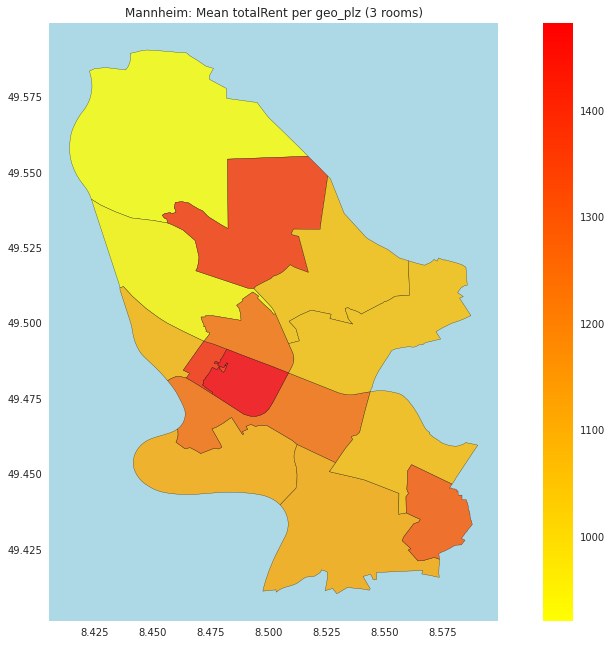

In [116]:
# filter & pivot mannheim df for data of 3 room appt.
df_mannheim_noro3 = df_mannheim[df_mannheim['noRooms'] == 3]
df_mannheim_noro3_pv = df_mannheim_noro3.pivot_table(values='totalRent', index='geo_plz', aggfunc=(np.mean)).reset_index()
df_mannheim_noro3_pv = df_mannheim_noro3_pv.sort_values(by=['totalRent'], ascending=False)
df_mannheim_noro3_pv['totalRent'] = df_mannheim_noro3_pv['totalRent'].astype(int)
df_mannheim_noro3_pv['geo_plz'] = df_mannheim_noro3_pv['geo_plz'].astype(str)
df_mannheim_noro3_pv.rename(columns={"geo_plz": "plz"}, inplace=True)

# create merged df for mannheim 3 room appt. based on pivoted immoscout data and zip shapes
mannheim_noro3_df = pd.merge(
    left=plz_shape_df, 
    right=df_mannheim_noro3_pv, 
    on='plz',
    how='left'
)

# drop tuples for zip codes without values
mannheim_noro3_df.dropna(subset = ["totalRent"], inplace=True)

# Plotting
fig, ax = plt.subplots()

mannheim_noro3_df.plot(
    ax=ax, 
    column='totalRent', 
    categorical=False, 
    legend=True, 
    cmap='autumn_r',
    alpha=0.8,
    edgecolor='black'
)

ax.set(
    title='Mannheim: Mean totalRent per geo_plz (3 rooms)', 
    aspect=1.3, 
    facecolor='lightblue'
)

# save plot as png for presentation
if outlier_removal_on == 0:
  plt.savefig(os.path.join(CURRENT_DIR,'png_mannheim_meanbyplz_3room.png'))
if outlier_removal_on == 1:
  plt.savefig(os.path.join(CURRENT_DIR,'png_mannheim_meanbyplz_3room_wo.png'))

plt.show()

# Save Dataframe for further processing

In [117]:
# Not used for pipleline anymore
# CURRENT_DIR = 'drive//MyDrive//IE_500_Data_Mining_I//MachineLearning//Input_Data'
# df.to_pickle(os.path.join(CURRENT_DIR,"df_exploratoryDataAnalysis.pkl"))